# Project 10 - Estimating stellar metallicities with S-PLUS photometry (Eduardo)

## Introduction

Traditionally, one may refer to stellar metallicity as a comparative quantity that works as a first approach to understanding the chemical composition of stars.The amount of iron (relative to hydrogen) of a star is denoted [Fe/H], where the brackets indicate a comparison against the Sun, and it approximately accounts for all elements other than hydrogen and helium present in its atmosphere. Metallicity values are usually estimated by means of spectroscopy, given that atomic transitions leave unique signatures on stellar spectra, but photometry can also be explored, especially if various broad and narrow band filters are available, as it is the case for the Southern Photometric Local Universe Survey (S-PLUS).

## Goal

With a set of 7 narrow-band filters along with 5 broad-band filters, S-PLUS provides information on sensitive regions of the spectrum that allow for consistent estimations of stellar metallicities. My goal is to estimate photometric metallicities focusing on metal-poor stars, since these Milky Way’s relics can give important information on the Galaxy formation and evolution.

## What am I going to do?

I am going to select stars from the S-PLUS DR2 with good photometry and search for their spectroscopic metallicities in various available surveys in literature. With these data, I’ll use LightGBM, a gradient-boosting python library, to estimate metallicities using information from S-PLUS filters.

# Code

## Imports & params

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import math as m
import numpy as np
import statistics as stat

import lightgbm as lgb

import astropy.units as u
from astropy.coordinates import SkyCoord
from astropy.table import Table, vstack
from astropy.io import fits

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

# %matplotlib inline

pd.options.display.max_columns = None
from matplotlib import rc
plt.rcParams["font.family"] = "serif"
plt.rcParams["figure.figsize"] = (10,8)
plt.rcParams['figure.dpi'] = 300
plt.rcParams["font.size"] = 13
plt.rcParams["xtick.direction"] = "in"
plt.rcParams["ytick.direction"] = "in"
plt.rcParams["xtick.minor.visible"] = True
plt.rcParams["ytick.minor.visible"] = True

In [ ]:
# # leitura das tabelas
# # xmatches feitos no topcat

# # apareceu um problema com byte-ordering usando esse arquivo fits para construir os dataframes,
# # então abandonei essa abordagem por questão de tempo
# # mais detalhes em https://pandas.pydata.org/pandas-docs/version/0.19.1/gotchas.html#byte-ordering-issues

# algumas tabelas (que envolvem apogee e pastel) não foram usadas
# fitsfile = 'sample_XMATCHES+SPLUS.fits'
# with fits.open(fitsfile) as data:
#     apogee = pd.DataFrame(data[1].data)
#     galahdr3 = pd.DataFrame(data[2].data)
#     lamostdr7 = pd.DataFrame(data[3].data)
#     pastel = pd.DataFrame(data[4].data)
#     segue = pd.DataFrame(data[5].data)
#     splus = pd.DataFrame(data[6].data)
#     splusxapogee = pd.DataFrame(data[7].data)
#     splusxgalahdr3 = pd.DataFrame(data[8].data)
#     splusxlamostdr7 = pd.DataFrame(data[9].data)
#     splusxpastel = pd.DataFrame(data[10].data)
#     splusxsegue = pd.DataFrame(data[11].data)

## Dados do S-PLUS

https://splus.cloud/ & Python ADQL
(células rodadas separadamente)

In [ ]:
caminho = '/home/eduardo/Área de Trabalho/SPLUS_data'
conn = splusdata.connect('user', 'password') ## from splus.cloud (necessário login com usuário e senha)

In [ ]:
# Checando lista de nomes de campos do DR2
url = 'https://raw.githubusercontent.com/Schwarzam/Data-analyse---SPLUS-objs/master/DR2_list_fields_reference.cat'
df = pd.read_table(url, error_bad_lines=False, delim_whitespace=True)

# Lista de nomes de campos
field_list = df.loc[:,"field"].values

In [ ]:
# Busca por dados do (tabelas separadas no DR2 exigem o uso de vários JOINs)

query = """SELECT
det.id, det.ra as RA, det.dec, det.field,
det.CLASS_STAR, sgq.CLASS, sgq.PROB_STAR,
u.u_auto, u.e_u_auto,
g.g_auto, g.e_g_auto,
r.r_auto, r.e_r_auto,
i.i_auto, i.e_i_auto,
z.z_auto, z.e_z_auto,
j0378.j0378_auto, j0378.e_J0378_auto,
j0395.j0395_auto, j0395.e_J0395_auto,
j0410.j0410_auto, j0410.e_J0410_auto,
j0430.j0430_auto, j0430.e_J0430_auto,
j0515.j0515_auto, j0515.e_J0515_auto,
j0660.j0660_auto, j0660.e_J0660_auto,
j0861.j0861_auto, j0861.e_J0861_auto
FROM
dr2.detection_image as det
join dr2_vacs.star_galaxy_quasar as sgq ON sgq.id = det.id
join dr2_vacs.splus_id as splus_id ON splus_id.id = det.id
join dr2.u_band as u ON u.id = det.id
join dr2.g_band as g ON g.id = det.id
join dr2.r_band as r ON r.id = det.id
join dr2.i_band as i ON i.id = det.id
join dr2.z_band as z ON z.id = det.id
join dr2.j0378_band as j0378 ON j0378.id = det.id
join dr2.j0395_band as j0395 ON j0395.id = det.id
join dr2.j0410_band as j0410 ON j0410.id = det.id
join dr2.j0430_band as j0430 ON j0430.id = det.id
join dr2.j0515_band as j0515 ON j0515.id = det.id
join dr2.j0660_band as j0660 ON j0660.id = det.id
join dr2.j0861_band as j0861 ON j0861.id = det.id
WHERE
det.CLASS_STAR > 0.7
AND sgq.CLASS = 1
AND sgq.PROB_STAR > 0.5
AND det.Field = '{campo}'
AND (det.s2n_Det_auto > 3)
AND splus_id.splusIDflag = 0
ORDER BY RA"""

In [ ]:
d = {} # dicionário para montagem da tabela

fulldata_stacked = Table() # tabela do AstroPy

for field in field_list:

    print('Buscando %s' % field )
    
    # Preparando busca pelo campo
    query_field = query.format(campo = field)

    # Substituindo quebra de linha por espaço na busca
    query_field = query_field.replace('\n',' ')

    # Carregando busca
    tab = conn.query(query_field)

    # Gerando nome do arquivo (para cada campo)
    nome_arquivo = caminho + '/%s.fits' % field
    nome_arquivo = nome_arquivo.replace('-', '_')
    
    # Salvando resultado da busca para cada campo (não é exatamente necessário)
    tab.write(nome_arquivo)
    
    # Criando nova variável para a função vstack for the function vstack
    #     pensando em reunir todos os dados em um tabela final única
    d["{0}".format(nome_arquivo[42:-5])] = Table.read(nome_arquivo, format='fits')
    print("Objetos no campo:", len(d["{0}".format(nome_arquivo[42:-5])]))
    
    for key,val in d.items():
        exec(key + '=val')
    
    fulldata_stacked = vstack([fulldata_stacked, d["{0}".format(nome_arquivo[42:-5])]],
                              metadata_conflicts='silent')
    print("\tFull table:",len(fulldata_stacked),"\n")

# Salvando tabela compilada final com resultados de todos os campos
fulldata_stacked.write('sample_splus_fulldata.fits')

O código para busca ADQL usado acima foi fornecido a mim por Felipe de Almeida Fernandes, que por sua vez o obteve com membros da colaboração desconhecidos por mim

## (Dados espectroscópicos fornecidos individualmente)

## Treinos com um catálogo único (x-match com SPLUS)

### LAMOST DR7 (maior catálogo: ~5.5kk)

#### Treino

In [2]:
# leitura
splusxlamostdr7 = pd.read_csv('sample_SPLUSxLAMOSTDR7LRS_1arcsec.csv')

# colunas de interesse (features)
print(splusxlamostdr7.columns[7:-9:2])
print(splusxlamostdr7.columns[8:-9:2])

Index(['u_auto', 'g_auto', 'r_auto', 'i_auto', 'z_auto', 'J0378_auto',
       'J0395_auto', 'J0410_auto', 'J0430_auto', 'J0515_auto', 'J0660_auto',
       'J0861_auto'],
      dtype='object')
Index(['e_u_auto', 'e_g_auto', 'e_r_auto', 'e_i_auto', 'e_z_auto',
       'e_J0378_auto', 'e_J0395_auto', 'e_J0410_auto', 'e_J0430_auto',
       'e_J0515_auto', 'e_J0660_auto', 'e_J0861_auto'],
      dtype='object')


In [3]:
splusfilters = splusxlamostdr7.columns[7:-9:2]
splusfilterserr = splusxlamostdr7.columns[8:-9:2]

for mag,err in zip(splusfilters, splusfilterserr):
    splusxlamostdr7 = splusxlamostdr7[(splusxlamostdr7[mag]<30) & (splusxlamostdr7[err]<1)]

splusxlamostdr7.head()

,ID,ra,DEC,Field,CLASS_STAR,CLASS,PROB_STAR,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto,obsid,ra.1,dec,logg,feh,teff_err,feh_err,logg_err,teff
0,DR2.SPLUS-s02s01.031113,323.997212,-1.451478,SPLUS-s02s01,0.929098,1.0,0.88,15.258354,0.003828,13.923990,0.001415,13.571979,0.001050,13.464681,0.001043,13.455411,0.001315,14.835467,0.004382,14.694057,0.005696,14.267606,0.004082,14.149340,0.003713,13.761033,0.002516,13.565353,0.001190,13.464637,0.001791,468611120,323.997181,-1.451460,4.222,-0.165,25.56,0.022,0.036,6249.84
1,DR2.SPLUS-s02s01.003480,324.016087,-2.016428,SPLUS-s02s01,0.980852,1.0,0.79,15.280623,0.003852,13.687926,0.001274,13.210247,0.000885,13.064041,0.000861,13.033619,0.001052,14.948107,0.004617,14.754108,0.005848,14.156301,0.003895,14.027614,0.003524,13.511259,0.002247,13.205422,0.001004,13.071153,0.001470,468609093,324.016048,-2.016374,4.316,0.141,27.56,0.021,0.037,5745.98
2,DR2.SPLUS-s02s01.019118,324.034345,-1.698325,SPLUS-s02s01,0.983332,1.0,0.96,15.492118,0.004300,14.044237,0.001499,13.604068,0.001066,13.439195,0.001031,13.399945,0.001275,15.099647,0.004993,14.966042,0.006541,14.464392,0.004511,14.351777,0.004111,13.870832,0.002654,13.582547,0.001200,13.422278,0.001751,468611074,324.034371,-1.698305,4.137,-0.209,26.68,0.021,0.037,5924.59
3,DR2.SPLUS-s02s01.006442,324.051558,-1.962753,SPLUS-s02s01,0.998385,1.0,0.57,15.336772,0.004013,13.221123,0.001023,12.623199,0.000671,12.330581,0.000604,12.131762,0.000662,15.004033,0.004806,14.724697,0.005831,13.988668,0.003602,13.778537,0.003131,13.004193,0.001767,12.461872,0.000708,12.159509,0.000934,468609079,324.051577,-1.962735,3.096,-0.339,27.13,0.020,0.036,4930.88
4,DR2.SPLUS-s02s01.029278,324.085371,-1.491019,SPLUS-s02s01,0.993841,1.0,0.87,16.419518,0.007275,14.436331,0.001802,13.735071,0.001133,13.438153,0.001024,13.302005,0.001201,16.028318,0.008400,15.853372,0.010931,15.160331,0.006462,14.986402,0.005677,14.224751,0.003139,13.645331,0.001234,13.339702,0.001670,468611121,324.085477,-1.490903,3.068,-0.573,30.66,0.025,0.042,4938.84


In [4]:
x_lamost = splusxlamostdr7[splusfilters]
y_lamost = splusxlamostdr7['feh']

X_train_lamost, X_test_lamost, y_train_lamost, y_test_lamost = train_test_split(x_lamost, y_lamost,
                                                                                test_size=0.05,
                                                                                random_state=42)
# Amostra de validação interna (X_val)
X_train_lamost, X_val_lamost, y_train_lamost, y_val_lamost = train_test_split(X_train_lamost, y_train_lamost,
                                                                              test_size=0.05264,
                                                                              random_state=42)

print('X_train:',len(X_train_lamost),'\tX_test:',len(X_test_lamost),'\tX_val:',len(X_val_lamost))
print('y_train:',len(y_train_lamost),'\ty_test:',len(y_test_lamost),'\ty_val:',len(y_val_lamost))
print('Sum:',len(X_train_lamost)+len(X_test_lamost)+len(X_val_lamost))
print('Dataset:',len(x_lamost))

X_train: 46251 	X_test: 2570 	X_val: 2570
y_train: 46251 	y_test: 2570 	y_val: 2570
Sum: 51391
Dataset: 51391


In [ ]:
# # Testes para encontrar melhores parâmetros
# # (deixei de lado quando começou a levar muito tempo
# #    e o "chute" à mão passou entregar resultados muito semelhantes)

# list_n_est = list(np.arange(4500,5500,100))
# list_max_depth = [2,3,4]
# list_num_leaves = [16,32,64,128]
# list_learning_rate = list(np.arange(0.1,0.12,0.01))

# for n_est in list_n_est:
#     for max_depth in list_max_depth:
#         for num_leaves in list_num_leaves:
#             for learning_rate in list_learning_rate:
#                 model = lgb.LGBMRegressor(objective='mean_absolute_error',
#                                           n_estimators=n_est,max_depth=-max_depth,num_leaves=num_leaves,
#                                           learning_rate=learning_rate, random_state=42)
#                 model.fit(X_train,y_train)                
#                 if model.score(X_test,y_test) >= 0.7:
#                 # print('MSE = %.2f' % (mean_squared_error(X_train,y_train)))
#                     print('n_estimators=%i,max_depth=-%i,num_leaves=%i,learning_rate=%.3f'
#                           % (n_est,max_depth,num_leaves,learning_rate))
#                     print('\tTraining accuracy {:.4f}'.format(model.score(X_train,y_train)))
#                     print('\tTesting accuracy {:.4f}'.format(model.score(X_test,y_test)))
#                     print('(Training - Testing) = %.3f\n'
#                           % (model.score(X_train,y_train)-model.score(X_test,y_test)))

Reading model...
Fitting model...
Model fit done.

n_estimators=2500,num_leaves=512
Calculating accuracies...
	Training accuracy: 0.9007
	Testing accuracy: 0.7093
(Training - Testing) = 0.191



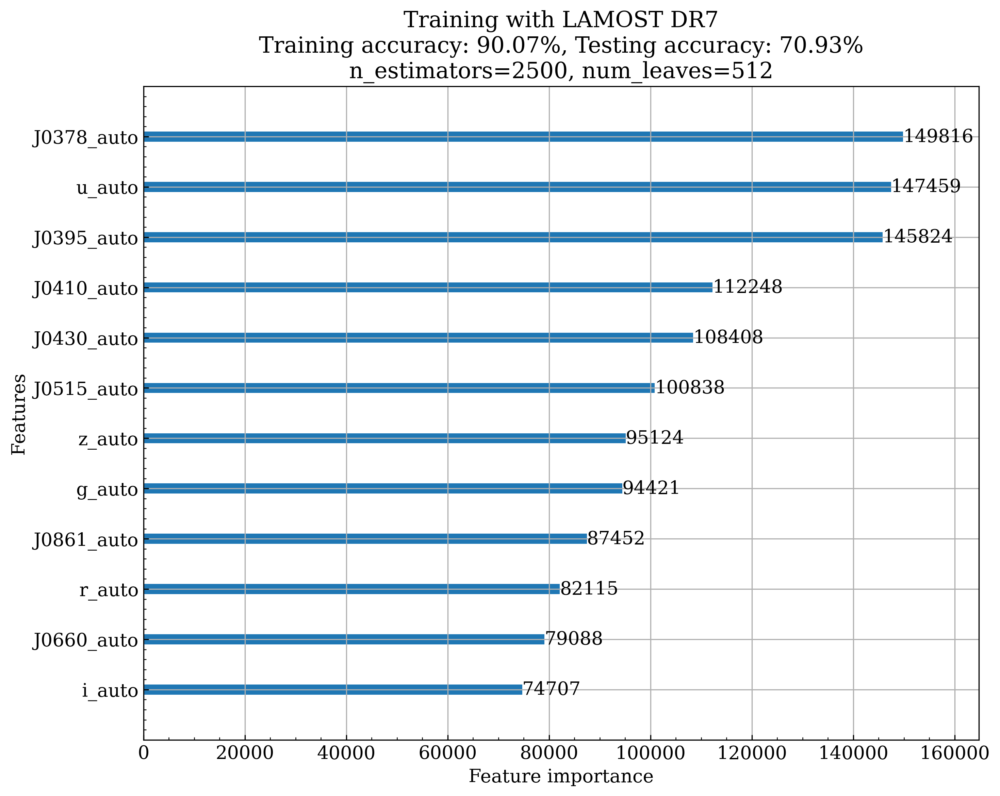

In [5]:
num_leaves = 512
n_est = 2500
# max_depth = -1 # percebi que variar para outros valores não melhorava
# learning_rate = 0.1 # percebi que variar para outros valores não melhorava

print('Reading model...')
model_lamost = lgb.LGBMRegressor(objective='mean_absolute_error',
                          n_estimators=n_est,num_leaves=num_leaves,random_state=42)
print('Fitting model...')
model_lamost.fit(X_train_lamost,y_train_lamost)                
print('Model fit done.\n')

print('n_estimators=%i,num_leaves=%i'
      % (n_est,num_leaves))

print('Calculating accuracies...')
print('\tTraining accuracy: {:.4f}'.format(model_lamost.score(X_train_lamost,y_train_lamost)))
print('\tTesting accuracy: {:.4f}'.format(model_lamost.score(X_test_lamost,y_test_lamost)))

print('(Training - Testing) = %.3f\n'
      % (model_lamost.score(X_train_lamost,y_train_lamost)-model_lamost.score(X_test_lamost,y_test_lamost)))


lgb.plot_importance(model_lamost,
                    title='Training with LAMOST DR7\nTraining accuracy: %.2f%%, Testing accuracy: %.2f%%\nn_estimators=%i, num_leaves=%i'
                    % (model_lamost.score(X_train_lamost,y_train_lamost)*100,
                       model_lamost.score(X_test_lamost,y_test_lamost)*100,
                       n_est,num_leaves))
plt.tight_layout()
plt.savefig('plot_ModelScore_SPLUSxLAMOSTDR7_FeatImp_Tacc%i.jpg'
            % (model_lamost.score(X_test_lamost,y_test_lamost)*10000))
plt.show()

#### Previsões: validação interna

In [6]:
# Validação interna
y_pred_intval_lamost = model_lamost.predict(X_val_lamost)
MAE_int_lamost = mean_absolute_error(y_val_lamost, y_pred_intval_lamost)

print('MAE (internal validation set) = %.4f' % (MAE_int_lamost))

MAE (internal validation set) = 0.1618


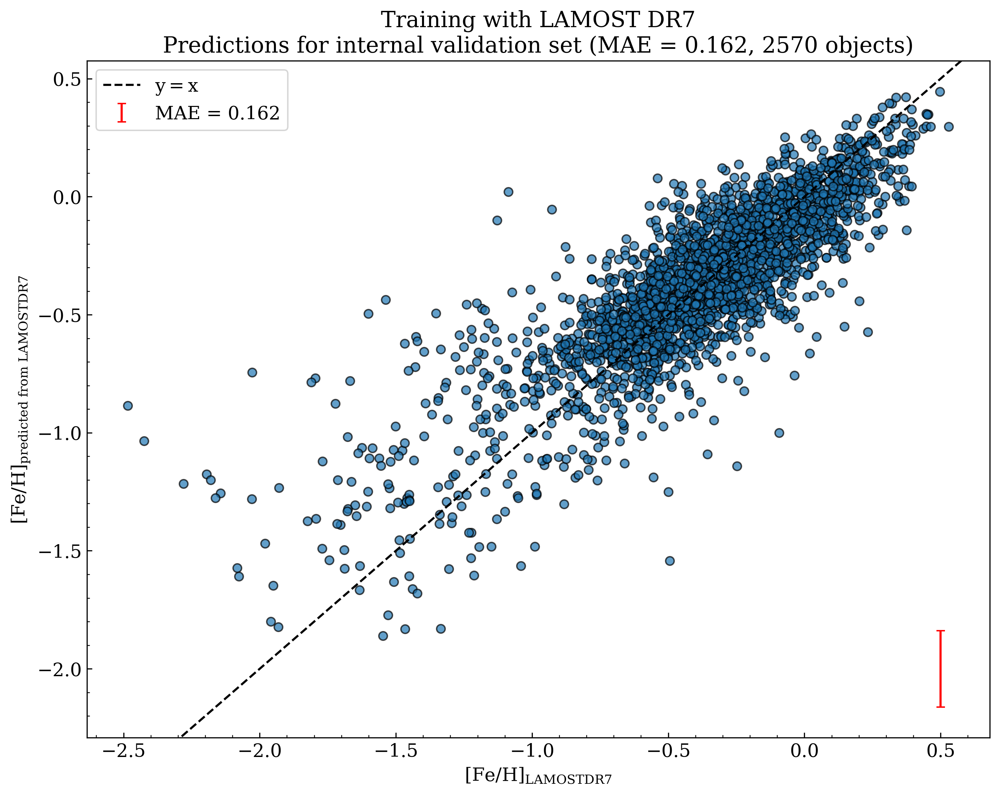

In [7]:
plt.scatter(y_val_lamost, y_pred_intval_lamost, alpha=0.7, c='C0', edgecolors='k')
plt.errorbar(0.5, -2, yerr=MAE_int_lamost, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
             % (MAE_int_lamost))

plt.xlabel('$\mathregular{[Fe/H]_{LAMOSTDR7}}$')
plt.ylabel('$\mathregular{[Fe/H]_{predicted~from~LAMOSTDR7}}$')
lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]
# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.title('Training with LAMOST DR7\nPredictions for internal validation set (MAE = %.3f, %i objects)'
          % (MAE_int_lamost,len(y_val_lamost)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelPred_SPLUSxLAMOSTDR7_internal.jpg')
plt.show()

#### Previsões: LAMOSTxGALAHDR3

In [8]:
# Validação externa (LAMOSTxGALAHDR3)

# leitura
splusxgalahdr3 = pd.read_csv('sample_SPLUSxGALAHDR3_1arcsec.csv')

# colunas de interesse (features)
print(splusxgalahdr3.columns[7:-11:2])
print(splusxgalahdr3.columns[8:-11:2])

splusxgalahdr3filters = splusxgalahdr3.columns[7:-11:2]
splusxgalahdr3serr = splusxgalahdr3.columns[8:-11:2]

for mag,err in zip(splusxgalahdr3filters, splusxgalahdr3serr):
    splusxgalahdr3 = splusxgalahdr3[(splusxgalahdr3[mag]<30) & (splusxgalahdr3[err]<1)]

splusxgalahdr3['feh_pred_lamosttrain'] = model_lamost.predict(splusxgalahdr3[splusxgalahdr3filters])

splusxgalahdr3.head()

Index(['u_auto', 'g_auto', 'r_auto', 'i_auto', 'z_auto', 'J0378_auto',
       'J0395_auto', 'J0410_auto', 'J0430_auto', 'J0515_auto', 'J0660_auto',
       'J0861_auto'],
      dtype='object')
Index(['e_u_auto', 'e_g_auto', 'e_r_auto', 'e_i_auto', 'e_z_auto',
       'e_J0378_auto', 'e_J0395_auto', 'e_J0410_auto', 'e_J0430_auto',
       'e_J0515_auto', 'e_J0660_auto', 'e_J0861_auto'],
      dtype='object')


,ID,ra_1,DEC_1,Field,CLASS_STAR,CLASS,PROB_STAR,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto,GALAH,RA_2,Dec_2,teff,teff_err,logg,logg_err,feh,feh_err,Survey,Separation,feh_pred_lamosttrain
0,DR2.HYDRA-0018.002711,160.992833,-24.570652,HYDRA-0018,0.855459,1.0,0.94,15.682273,0.005171,14.239698,0.001945,13.757572,0.001119,13.564385,0.001078,13.495413,0.001299,15.386316,0.006332,15.282532,0.008726,14.687606,0.005869,14.597679,0.005470,14.070565,0.003342,13.738476,0.001287,13.525011,0.001840,150330002201233,160.992871,-24.570649,5457.26,146.36,4.411641,0.196769,-0.555406,0.155525,GALAH,0.122443,-0.216327
1,DR2.HYDRA-0018.001634,161.019361,-24.597071,HYDRA-0018,0.701628,1.0,0.86,16.878016,0.012631,14.630384,0.002504,13.884460,0.001191,13.561078,0.001078,13.402447,0.001239,16.492899,0.014224,16.228905,0.017539,15.493150,0.010440,15.231249,0.008533,14.399680,0.004120,13.811029,0.001334,13.455093,0.001777,150330002201232,161.019342,-24.597085,4649.35,161.52,2.390370,0.274853,-0.509535,0.140575,GALAH,0.081048,-0.584559
2,DR2.HYDRA-0018.007977,161.104840,-24.431380,HYDRA-0018,0.926744,1.0,0.91,14.891196,0.003092,13.623210,0.001328,13.326815,0.000908,13.230637,0.000906,13.222094,0.001113,14.477462,0.003569,14.301364,0.004660,13.914069,0.003542,13.809313,0.003288,13.504589,0.002358,13.354189,0.001067,13.246302,0.001579,150330002201244,161.104820,-24.431376,6296.50,108.84,4.190133,0.183755,-0.277028,0.144632,GALAH,0.065234,-0.421063
3,DR2.HYDRA-0018.012918,161.371681,-24.295397,HYDRA-0018,0.883925,1.0,0.76,16.517632,0.009165,14.195079,0.001819,13.430509,0.000955,13.132179,0.000860,12.993016,0.000985,16.254517,0.011400,15.810611,0.012334,15.087198,0.007312,14.824010,0.006054,14.029825,0.003137,13.348373,0.001066,13.039777,0.001417,150330002201263,161.371659,-24.295383,4779.53,117.98,3.289266,0.204163,-0.159329,0.101917,GALAH,0.086005,0.066514
4,DR2.HYDRA-0018.011735,161.386880,-24.324638,HYDRA-0018,0.736761,1.0,0.87,16.392492,0.008221,14.520291,0.002199,13.849561,0.001166,13.556412,0.001056,13.424841,0.001226,16.027025,0.009512,15.875206,0.012741,15.207213,0.007847,15.066615,0.007050,14.327849,0.003723,13.778940,0.001308,13.477319,0.001763,150330002201261,161.386851,-24.324645,4981.80,151.68,2.851746,0.258909,-0.643096,0.138042,GALAH,0.100016,-0.575330


In [9]:
MAE_lamost_galah = mean_absolute_error(splusxgalahdr3['feh'], splusxgalahdr3['feh_pred_lamosttrain'])

print('MAE (external GALAH DR3 validation set) = %.4f' % (MAE_lamost_galah))

MAE (external GALAH DR3 validation set) = 0.1490


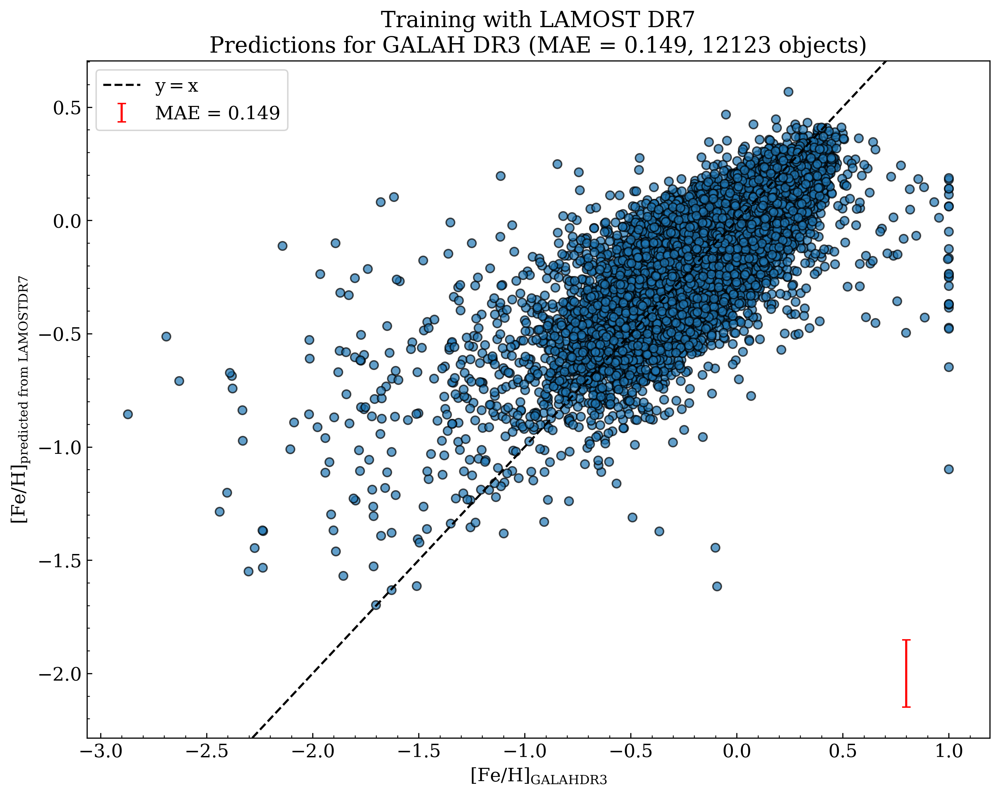

In [10]:
plt.scatter(splusxgalahdr3['feh'], splusxgalahdr3['feh_pred_lamosttrain'],
            alpha=0.7, c='C0', edgecolors='k')
plt.errorbar(0.8, -2, yerr=MAE_lamost_galah, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
             % (MAE_lamost_galah))

plt.xlabel('$\mathregular{[Fe/H]_{GALAHDR3}}$')
plt.ylabel('$\mathregular{[Fe/H]_{predicted~from~LAMOSTDR7}}$')
lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]
# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.title('Training with LAMOST DR7\nPredictions for GALAH DR3 (MAE = %.3f, %i objects)'
          % (MAE_lamost_galah,len(splusxgalahdr3)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelPred_SPLUSxLAMOSTDR7_GALAHDR3.jpg')
plt.show()

#### Previsões: LAMOSTDR7xSEGUE

In [11]:
# Validação externa (SEGUExLAMOST)

splusxsegue = pd.read_csv('sample_SPLUSxSEGUE_1arcsec.csv')

splusfilters = splusxsegue.columns[7:31:2]
splusfilterserr = splusxsegue.columns[8:31:2]

for mag,err in zip(splusfilters, splusfilterserr):
    splusxsegue = splusxsegue[(splusxsegue[mag]<30) & (splusxsegue[err]<1)]

splusxsegue['feh_pred_lamosttrain'] = model_lamost.predict(splusxsegue[splusfilters])

splusxsegue.head()

,ID,ra_1,DEC_1,Field,CLASS_STAR,CLASS,PROB_STAR,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto,SPECOBJID,RA_2,Dec_2,teff,teff_err,logg,logg_err,feh,feh_err,Survey,Separation,feh_pred_lamosttrain
0,DR2.SPLUS-s02s08.035690,333.710801,-1.183019,SPLUS-s02s08,0.983169,1.0,1.00,20.793396,0.148817,18.756294,0.021623,17.989296,0.012517,17.667543,0.013956,17.515154,0.022079,20.620388,0.216794,20.154177,0.240798,19.438042,0.113854,19.366990,0.103415,18.588814,0.043646,17.886417,0.013528,17.513594,0.025887,3542084210661629952,333.71082,-1.183000,5131.271,47.91368,4.369143,0.069041,-0.523808,0.079765,SEGUE,0.096305,-0.570651
1,DR2.SPLUS-s02s08.053204,333.732893,-0.866673,SPLUS-s02s08,0.983756,1.0,1.00,20.737017,0.140770,18.568722,0.018760,17.695866,0.010070,17.349072,0.010856,17.161327,0.016270,20.851587,0.264990,20.106052,0.229341,19.581457,0.129057,19.278402,0.095872,18.481710,0.040083,17.592928,0.010913,17.247932,0.020741,3542096580167442432,333.73286,-0.866668,4822.348,77.56346,4.611819,0.077234,-0.741584,0.091629,SEGUE,0.121767,-0.288807
2,DR2.SPLUS-s02s08.054201,333.750709,-0.890666,SPLUS-s02s08,0.982474,1.0,1.00,18.400470,0.021407,17.143414,0.007176,16.647339,0.005084,16.408577,0.005511,16.353537,0.008584,18.031970,0.026074,17.870344,0.036355,17.546543,0.025447,17.434063,0.022666,16.959555,0.013424,16.620531,0.005824,16.381649,0.010719,3542095755533721600,333.75084,-0.890603,5664.399,205.61610,3.989091,0.156594,-1.588903,0.106221,SEGUE,0.521160,-0.982713
3,DR2.SPLUS-s02s24.029792,356.235718,-0.706527,SPLUS-s02s24,0.842685,1.0,1.00,17.219694,0.012084,16.074589,0.005928,15.746598,0.003852,15.631734,0.003833,15.625130,0.005403,16.763935,0.014369,16.610174,0.020160,16.364624,0.017161,16.250504,0.015938,15.924587,0.010185,15.769243,0.004453,15.634855,0.007123,2141488615727851520,356.23574,-0.706442,6196.415,21.71860,3.922815,0.102339,-1.505844,0.040846,SEGUE,0.315980,-0.887485
4,DR2.SPLUS-s02s24.026250,356.387101,-1.235413,SPLUS-s02s24,0.983051,1.0,0.99,20.326464,0.120640,19.369488,0.069728,18.904314,0.036528,18.831703,0.038791,18.797733,0.059747,20.040974,0.168407,19.571737,0.185106,19.398111,0.168208,19.319427,0.160601,18.968033,0.094819,18.908470,0.041250,18.862562,0.079335,2142612043176372224,356.38710,-1.235387,6237.610,40.01406,3.419827,0.193246,-1.209188,0.024191,SEGUE,0.095430,-0.838466


In [12]:
# Validação externa
MAE_lamost_segue = mean_absolute_error(splusxsegue['feh'], splusxsegue['feh_pred_lamosttrain'])

print('MAE (external SEGUE validation set) = %.4f' % (MAE_lamost_segue))

MAE (external SEGUE validation set) = 0.4111


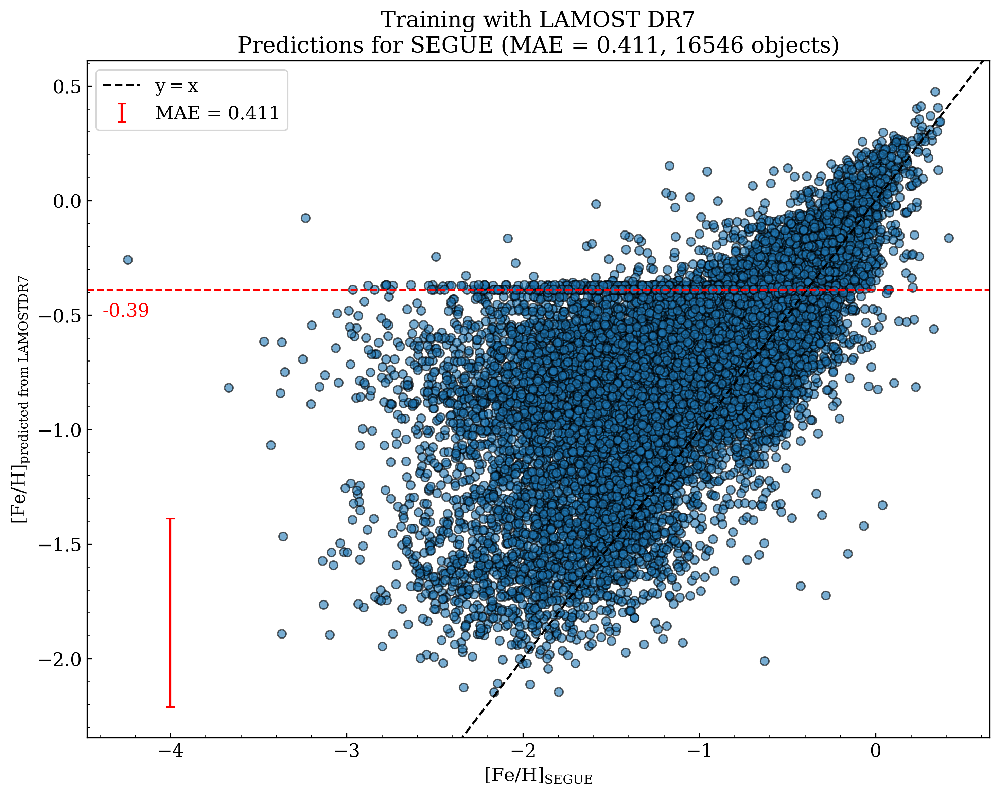

In [13]:
plt.scatter(splusxsegue['feh'], splusxsegue['feh_pred_lamosttrain'],
            alpha=0.6, c='C0', edgecolors='k')
plt.errorbar(-4, -1.8, yerr=MAE_lamost_segue, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
             % (MAE_lamost_segue))

plt.xlabel('$\mathregular{[Fe/H]_{SEGUE}}$')
plt.ylabel('$\mathregular{[Fe/H]_{predicted~from~LAMOSTDR7}}$')

lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]

# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.axhline(stat.mode(splusxsegue['feh_pred_lamosttrain']), color='r', ls='--', lw=1.3)
plt.text(x=np.min(plt.gca().get_xlim())*0.98,y=stat.mode(splusxsegue['feh_pred_lamosttrain'])*1.3,
         color='r', s='%.2f' % (stat.mode(splusxsegue['feh_pred_lamosttrain'])))

plt.title('Training with LAMOST DR7\nPredictions for SEGUE (MAE = %.3f, %i objects)'
          % (MAE_lamost_segue,len(splusxsegue)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelPred_SPLUSxLAMOSTDR7_SEGUE.jpg')
plt.show()

#### Tentativas com GridSearchCV (abandonado, rodando para sempre...)

In [ ]:
# # n_est = 3680
# # max_depth = -4
# # num_leaves = 16
# # learning_rate = 0.12

# # model = lgb.LGBMRegressor(objective='l1',
# #                           n_estimators=n_est,max_depth=max_depth,num_leaves=num_leaves,
# #                           learning_rate=learning_rate, random_state=42)

# print("Reading model...")
# model = lgb.LGBMRegressor(objective='mean_absolute_error', random_state=42)
# print("Model read:", model, "\n\n")

# print("Reading parameters ranges for search with gridSearchCV...")
# params_opt = {'learning_rate': np.arange(0.09, 0.111, 0.01),
#               'max_depth': np.arange(-4,-1,1),
#               'n_estimators': np.arange(100, 402, 50),
#               'num_leaves': np.arange(2,10,2)
#               }
# print("Parameters read.")
# for key,value in params_opt.items():
#   print("\t", key+":\n\t\t", value)

# from sklearn import preprocessing
# X_train = preprocessing.scale(X_train)

# print("Searching for best set of parameters...")
# gridSearchCV = GridSearchCV(estimator = model, 
#     param_grid = params_opt, 
#     scoring='neg_mean_absolute_error',
#     n_jobs = 1)
# print("Fitting best set of parameters...")
# gridSearchCV.fit(X_train,y_train)

# print(gridSearchCV.best_params_)
# print(gridSearchCV.best_score_)

In [126]:
n_est = gridSearchCV.best_params_['n_estimators']
max_depth = gridSearchCV.best_params_['max_depth']
num_leaves = gridSearchCV.best_params_['num_leaves']
learning_rate = gridSearchCV.best_params_['learning_rate']

model = lgb.LGBMRegressor(objective='mean_absolute_error',
                          n_estimators=n_est,max_depth=max_depth,num_leaves=num_leaves,
                          learning_rate=learning_rate, random_state=42)
model.fit(X_train,y_train)                
# if model.score(X_test,y_test) >= 0.71:
print('n_estimators=%i,max_depth=%i,num_leaves=%i,learning_rate=%.3f'
  % (n_est,max_depth,num_leaves,learning_rate))
print('\tTraining accuracy {:.4f}'.format(model.score(X_train,y_train)))
print('\tTesting accuracy {:.4f}'.format(model.score(X_test,y_test)))
print('(Training - Testing) = %.3f\n'
  % (model.score(X_train,y_train)-model.score(X_test,y_test)))

# lgb.plot_importance(model,
#                     title='Training accuracy: %.2f%%, Testing accuracy: %.2f%%\nn_estimators=%i, max_depth=%i, num_leaves=%i, learning_rate=%.3f'
#                     % (model.score(X_train,y_train)*100,model.score(X_test,y_test)*100,
#                        n_est,max_depth,num_leaves,learning_rate))
# # plt.savefig('plot_ModelScore_FeatImp_Tacc%i.jpg' %(model.score(X_test,y_test)*10000))
# plt.show()

n_estimators=300,max_depth=--6,num_leaves=4,learning_rate=0.200
	Training accuracy 0.5432
	Testing accuracy 0.5082
(Training - Testing) = 0.035



### SEGUE (maior cobertura: -4.47<[Fe/H]<0.75)

#### Treino

In [14]:
splusxsegue = pd.read_csv('sample_SPLUSxSEGUE_1arcsec.csv')

splusfilters = splusxsegue.columns[7:31:2]
splusfilterserr = splusxsegue.columns[8:31:2]

for mag,err in zip(splusfilters, splusfilterserr):
    splusxsegue = splusxsegue[(splusxsegue[mag]<30) & (splusxsegue[err]<1)]

splusxsegue.head()

# plt.hist(splusxsegue['feh'], bins=60) # chamei essa função depois que vi os plots 
#     com aqueles gargalos, mas deixo comentada)
# plt.show()

,ID,ra_1,DEC_1,Field,CLASS_STAR,CLASS,PROB_STAR,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto,SPECOBJID,RA_2,Dec_2,teff,teff_err,logg,logg_err,feh,feh_err,Survey,Separation
0,DR2.SPLUS-s02s08.035690,333.710801,-1.183019,SPLUS-s02s08,0.983169,1.0,1.00,20.793396,0.148817,18.756294,0.021623,17.989296,0.012517,17.667543,0.013956,17.515154,0.022079,20.620388,0.216794,20.154177,0.240798,19.438042,0.113854,19.366990,0.103415,18.588814,0.043646,17.886417,0.013528,17.513594,0.025887,3542084210661629952,333.71082,-1.183000,5131.271,47.91368,4.369143,0.069041,-0.523808,0.079765,SEGUE,0.096305
1,DR2.SPLUS-s02s08.053204,333.732893,-0.866673,SPLUS-s02s08,0.983756,1.0,1.00,20.737017,0.140770,18.568722,0.018760,17.695866,0.010070,17.349072,0.010856,17.161327,0.016270,20.851587,0.264990,20.106052,0.229341,19.581457,0.129057,19.278402,0.095872,18.481710,0.040083,17.592928,0.010913,17.247932,0.020741,3542096580167442432,333.73286,-0.866668,4822.348,77.56346,4.611819,0.077234,-0.741584,0.091629,SEGUE,0.121767
2,DR2.SPLUS-s02s08.054201,333.750709,-0.890666,SPLUS-s02s08,0.982474,1.0,1.00,18.400470,0.021407,17.143414,0.007176,16.647339,0.005084,16.408577,0.005511,16.353537,0.008584,18.031970,0.026074,17.870344,0.036355,17.546543,0.025447,17.434063,0.022666,16.959555,0.013424,16.620531,0.005824,16.381649,0.010719,3542095755533721600,333.75084,-0.890603,5664.399,205.61610,3.989091,0.156594,-1.588903,0.106221,SEGUE,0.521160
3,DR2.SPLUS-s02s24.029792,356.235718,-0.706527,SPLUS-s02s24,0.842685,1.0,1.00,17.219694,0.012084,16.074589,0.005928,15.746598,0.003852,15.631734,0.003833,15.625130,0.005403,16.763935,0.014369,16.610174,0.020160,16.364624,0.017161,16.250504,0.015938,15.924587,0.010185,15.769243,0.004453,15.634855,0.007123,2141488615727851520,356.23574,-0.706442,6196.415,21.71860,3.922815,0.102339,-1.505844,0.040846,SEGUE,0.315980
4,DR2.SPLUS-s02s24.026250,356.387101,-1.235413,SPLUS-s02s24,0.983051,1.0,0.99,20.326464,0.120640,19.369488,0.069728,18.904314,0.036528,18.831703,0.038791,18.797733,0.059747,20.040974,0.168407,19.571737,0.185106,19.398111,0.168208,19.319427,0.160601,18.968033,0.094819,18.908470,0.041250,18.862562,0.079335,2142612043176372224,356.38710,-1.235387,6237.610,40.01406,3.419827,0.193246,-1.209188,0.024191,SEGUE,0.095430


In [15]:
x_segue = splusxsegue[splusfilters]
y_segue = splusxsegue['feh']

X_train_segue, X_test_segue, y_train_segue, y_test_segue = train_test_split(x_segue, y_segue, test_size=0.05,  random_state=42)
# Amostra de validação interna (X_val)
X_train_segue, X_val_segue, y_train_segue, y_val_segue = train_test_split(X_train_segue, y_train_segue, test_size=0.05265, random_state=42)

print('X_train:',len(X_train_segue),'\tX_test:',len(X_test_segue), '\tX_val:',len(X_val_segue))
print('y_train:',len(y_train_segue),'\ty_test:',len(y_test_segue), '\ty_val:',len(y_val_segue))
print('Sum:',len(X_train_segue)+len(X_test_segue)+len(X_val_segue))
print('Dataset:',len(x_segue))

X_train: 14890 	X_test: 828 	X_val: 828
y_train: 14890 	y_test: 828 	y_val: 828
Sum: 16546
Dataset: 16546


In [ ]:
# # Tests for finding best params
# # (deixei de lado quando começou a levar muito tempo
# #    e o "chute" à mão passou entregar resultados muito semelhantes)

# list_n_est = list(np.arange(3800,4210,10))
# list_max_depth = [2,3,4]
# list_num_leaves = [2**(2*i) for i in list_max_depth]
# list_learning_rate = list(np.arange(0.05,0.12,0.001))

# for n_est in list_n_est:
#     for max_depth in list_max_depth:
#         for num_leaves in list_num_leaves:
#             for learning_rate in list_learning_rate:
#                 model = lgb.LGBMRegressor(objective='mse',
#                                           n_estimators=n_est,max_depth=max_depth,num_leaves=num_leaves,
#                                           learning_rate=learning_rate, random_state=42)
#                 model.fit(X_train,y_train)                
#                 if model.score(X_test,y_test) >= 0.62:
#                 # print('MSE = %.2f' % (mean_squared_error(X_train,y_train)))
#                     print('n_estimators=%i,max_depth=-%i,num_leaves=%i,learning_rate=%.3f'
#                           % (n_est,max_depth,num_leaves,learning_rate))
#                     print('\tTraining accuracy {:.4f}'.format(model.score(X_train,y_train)))
#                     print('\tTesting accuracy {:.4f}'.format(model.score(X_test,y_test)))
#                     print('(Training - Testing) = %.3f\n'
#                           % (model.score(X_train,y_train)-model.score(X_test,y_test)))

# # lgb.plot_importance(model,
# #                     title='Training accuracy: %.2f%%, Testing accuracy: %.2f%%\nn_estimators=%i, max_depth=%i, num_leaves=%i, learning_rate=%.3f'
# #                     % (model.score(X_train,y_train)*100,model.score(X_test,y_test)*100,
# #                        n_est,max_depth,num_leaves,learning_rate))
# # # plt.savefig('plot_ModelScore_FeatImp_Tacc%i.jpg' %(model.score(X_test,y_test)*10000))
# # plt.show()

Reading model...
Fitting model...
Model fit done.

n_estimators=2500,num_leaves=512
Calculating accuracies...
	Training accuracy: 0.8968
	Testing accuracy: 0.6100
(Training - Testing) = 0.287



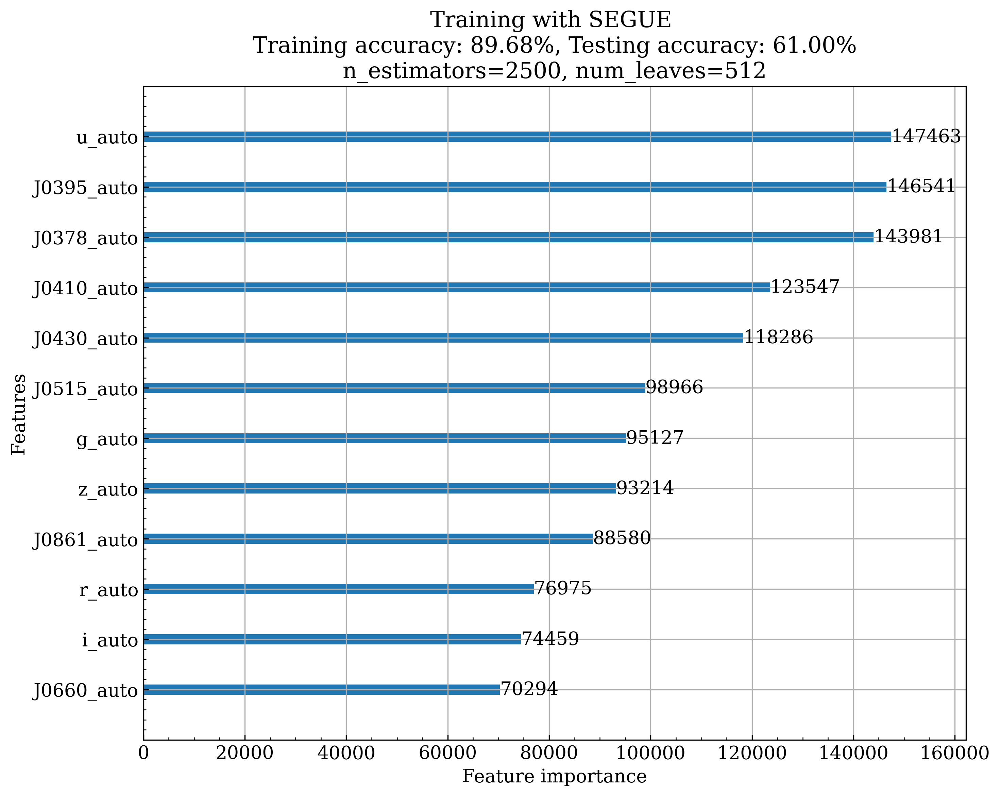

In [16]:
num_leaves = 512
n_est = 2500
# max_depth = -1 # percebi que variar para outros valores não melhorava
# learning_rate = 0.1 # percebi que variar para outros valores não melhorava

print('Reading model...')
model_segue = lgb.LGBMRegressor(objective='mae',
                          n_estimators=n_est,num_leaves=num_leaves,random_state=42)

print('Fitting model...')
model_segue.fit(X_train_segue,y_train_segue)  
print('Model fit done.\n')

print('n_estimators=%i,num_leaves=%i'
      % (n_est,num_leaves))

print('Calculating accuracies...')
print('\tTraining accuracy: {:.4f}'.format(model_segue.score(X_train_segue,y_train_segue)))
print('\tTesting accuracy: {:.4f}'.format(model_segue.score(X_test_segue,y_test_segue)))
print('(Training - Testing) = %.3f\n'
      % (model_segue.score(X_train_segue,y_train_segue)-model_segue.score(X_test_segue,y_test_segue)))

lgb.plot_importance(model_segue,
                    title='Training with SEGUE \nTraining accuracy: %.2f%%, Testing accuracy: %.2f%%\nn_estimators=%i, num_leaves=%i'
                    % (model_segue.score(X_train_segue,y_train_segue)*100,
                       model_segue.score(X_test_segue,y_test_segue)*100,
                       n_est,num_leaves))
plt.tight_layout()
plt.savefig('plot_ModelScore_SPLUSxSEGUE_FeatImp_Tacc%i.jpg'
            %(model_segue.score(X_test_segue,y_test_segue)*10000))
plt.show()

#### Previsões: validação interna

In [17]:
# Validação interna
y_pred_intval_segue = model_segue.predict(X_val_segue)
MAE_int_segue = mean_absolute_error(y_val_segue, y_pred_intval_segue)

print('MAE (internal validation set) = %.4f' % (MAE_int_segue))

MAE (internal validation set) = 0.2866


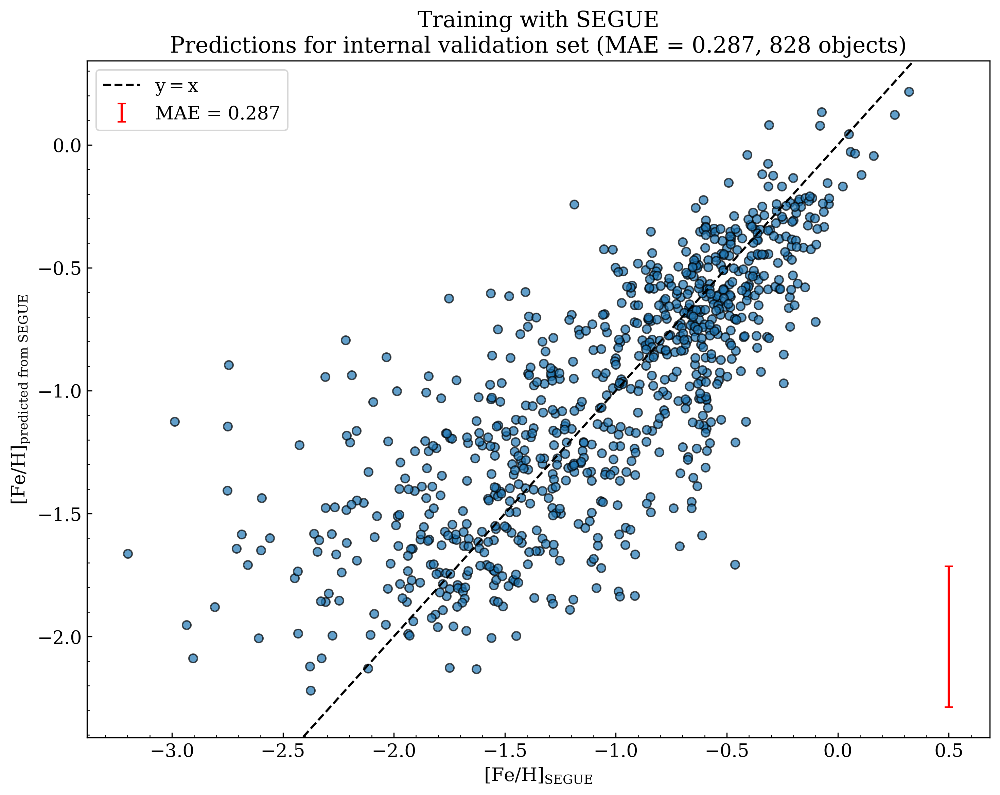

In [18]:
plt.scatter(y_val_segue, y_pred_intval_segue, alpha=0.7, c='C0', edgecolors='k')
plt.errorbar(0.5, -2, yerr=MAE_int_segue, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
             % (MAE_int_segue))

plt.xlabel('$\mathregular{[Fe/H]_{SEGUE}}$')
plt.ylabel('$\mathregular{[Fe/H]_{predicted~from~SEGUE}}$')
lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]
# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.title('Training with SEGUE\nPredictions for internal validation set (MAE = %.3f, %i objects)'
          % (MAE_int_segue,len(y_val_segue)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelPred_SPLUSxSEGUE_internal.jpg')
plt.show()

#### Previsões: SEGUExGALAHDR3

In [19]:
# Amostra de validação externa (SEGUExGALAH)
splusxgalahdr3 = pd.read_csv('sample_SPLUSxGALAHDR3_1arcsec.csv')

splusfilters = splusxgalahdr3.columns[7:31:2]
splusfilterserr = splusxgalahdr3.columns[8:31:2]

for mag,err in zip(splusfilters, splusfilterserr):
    splusxgalahdr3 = splusxgalahdr3[(splusxgalahdr3[mag]<30) & (splusxgalahdr3[err]<1)]

splusxgalahdr3['feh_pred_seguetrain'] = model_segue.predict(splusxgalahdr3[splusfilters])

splusxgalahdr3.head()

,ID,ra_1,DEC_1,Field,CLASS_STAR,CLASS,PROB_STAR,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto,GALAH,RA_2,Dec_2,teff,teff_err,logg,logg_err,feh,feh_err,Survey,Separation,feh_pred_seguetrain
0,DR2.HYDRA-0018.002711,160.992833,-24.570652,HYDRA-0018,0.855459,1.0,0.94,15.682273,0.005171,14.239698,0.001945,13.757572,0.001119,13.564385,0.001078,13.495413,0.001299,15.386316,0.006332,15.282532,0.008726,14.687606,0.005869,14.597679,0.005470,14.070565,0.003342,13.738476,0.001287,13.525011,0.001840,150330002201233,160.992871,-24.570649,5457.26,146.36,4.411641,0.196769,-0.555406,0.155525,GALAH,0.122443,-0.448212
1,DR2.HYDRA-0018.001634,161.019361,-24.597071,HYDRA-0018,0.701628,1.0,0.86,16.878016,0.012631,14.630384,0.002504,13.884460,0.001191,13.561078,0.001078,13.402447,0.001239,16.492899,0.014224,16.228905,0.017539,15.493150,0.010440,15.231249,0.008533,14.399680,0.004120,13.811029,0.001334,13.455093,0.001777,150330002201232,161.019342,-24.597085,4649.35,161.52,2.390370,0.274853,-0.509535,0.140575,GALAH,0.081048,-0.025990
2,DR2.HYDRA-0018.007977,161.104840,-24.431380,HYDRA-0018,0.926744,1.0,0.91,14.891196,0.003092,13.623210,0.001328,13.326815,0.000908,13.230637,0.000906,13.222094,0.001113,14.477462,0.003569,14.301364,0.004660,13.914069,0.003542,13.809313,0.003288,13.504589,0.002358,13.354189,0.001067,13.246302,0.001579,150330002201244,161.104820,-24.431376,6296.50,108.84,4.190133,0.183755,-0.277028,0.144632,GALAH,0.065234,-0.448212
3,DR2.HYDRA-0018.012918,161.371681,-24.295397,HYDRA-0018,0.883925,1.0,0.76,16.517632,0.009165,14.195079,0.001819,13.430509,0.000955,13.132179,0.000860,12.993016,0.000985,16.254517,0.011400,15.810611,0.012334,15.087198,0.007312,14.824010,0.006054,14.029825,0.003137,13.348373,0.001066,13.039777,0.001417,150330002201263,161.371659,-24.295383,4779.53,117.98,3.289266,0.204163,-0.159329,0.101917,GALAH,0.086005,0.010848
4,DR2.HYDRA-0018.011735,161.386880,-24.324638,HYDRA-0018,0.736761,1.0,0.87,16.392492,0.008221,14.520291,0.002199,13.849561,0.001166,13.556412,0.001056,13.424841,0.001226,16.027025,0.009512,15.875206,0.012741,15.207213,0.007847,15.066615,0.007050,14.327849,0.003723,13.778940,0.001308,13.477319,0.001763,150330002201261,161.386851,-24.324645,4981.80,151.68,2.851746,0.258909,-0.643096,0.138042,GALAH,0.100016,-0.247793


In [20]:
# Validação externa (SEGUExGALAH)
MAE_segue_galah = mean_absolute_error(splusxgalahdr3['feh'], splusxgalahdr3['feh_pred_seguetrain'])

print('MAE (external GALAH DR3 validation set) = %.4f' % (MAE_segue_galah))

MAE (external GALAH DR3 validation set) = 0.3013


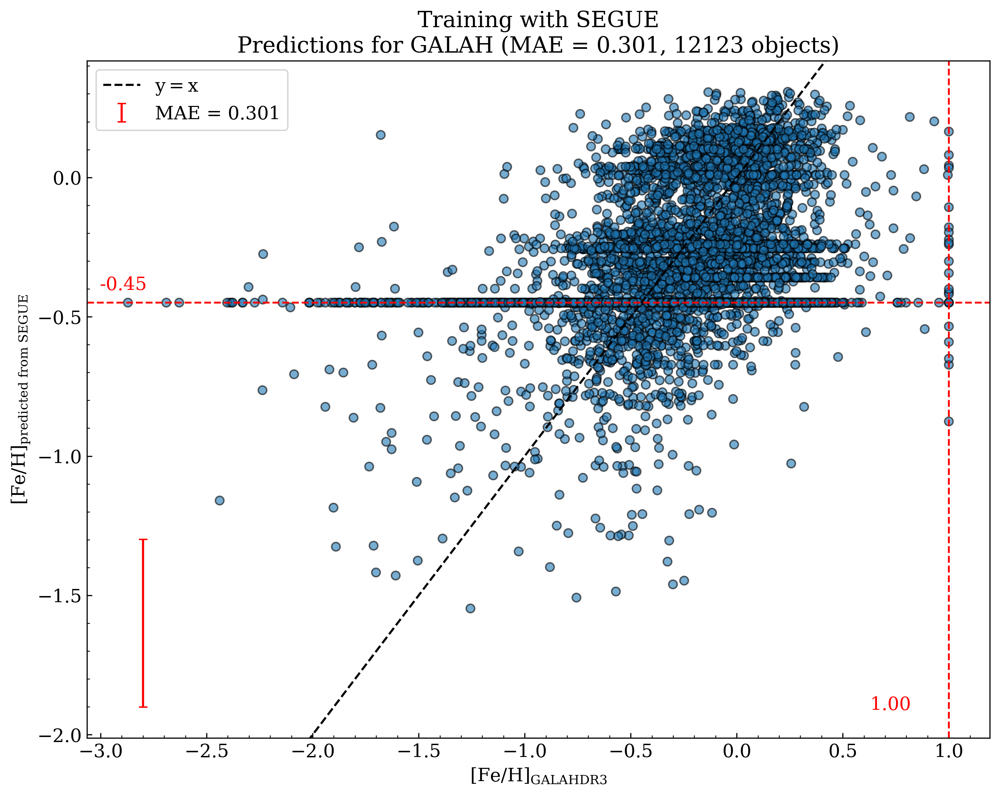

In [21]:
plt.scatter(splusxgalahdr3['feh'], splusxgalahdr3['feh_pred_seguetrain'], alpha=0.6, c='C0', edgecolors='k')
plt.errorbar(-2.8, -1.6, yerr=MAE_segue_galah, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
             % (MAE_segue_galah))

plt.xlabel('$\mathregular{[Fe/H]_{GALAHDR3}}$')
plt.ylabel('$\mathregular{[Fe/H]_{predicted~from~SEGUE}}$')

lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]

# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.axhline(stat.mode(splusxgalahdr3['feh_pred_seguetrain']), color='r', ls='--', lw=1.3)
plt.text(x=np.min(plt.gca().get_xlim())*0.98,y=stat.mode(splusxgalahdr3['feh_pred_seguetrain'])*0.9,
         color='r', s='%.2f' % (stat.mode(splusxgalahdr3['feh_pred_seguetrain'])))

plt.axvline(stat.mode(splusxgalahdr3['feh']), color='r', ls='--', lw=1.3)
plt.text(x=np.max(plt.gca().get_ylim())*1.5,y=np.min(plt.gca().get_ylim())*0.95,
         color='r', s='%.2f' % (stat.mode(splusxgalahdr3['feh'])))

plt.title('Training with SEGUE\nPredictions for GALAH (MAE = %.3f, %i objects)'
          % (MAE_segue_galah,len(splusxgalahdr3)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelPred_SPLUSxSEGUE_GALAHDR3.jpg')
plt.show()

#### Previsões: SEGUExLAMOSTDR7

In [22]:
# Amostra de validação externa (SEGUExLAMOST)
splusxlamostdr7 = pd.read_csv('sample_SPLUSxLAMOSTDR7LRS_1arcsec.csv')

splusfilters = splusxlamostdr7.columns[7:31:2]
splusfilterserr = splusxlamostdr7.columns[8:31:2]

for mag,err in zip(splusfilters, splusfilterserr):
    splusxlamostdr7 = splusxlamostdr7[(splusxlamostdr7[mag]<30) & (splusxlamostdr7[err]<1)]

splusxlamostdr7['feh_pred_seguetrain'] = model_segue.predict(splusxlamostdr7[splusfilters])

splusxlamostdr7.head()

,ID,ra,DEC,Field,CLASS_STAR,CLASS,PROB_STAR,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto,obsid,ra.1,dec,logg,feh,teff_err,feh_err,logg_err,teff,feh_pred_seguetrain
0,DR2.SPLUS-s02s01.031113,323.997212,-1.451478,SPLUS-s02s01,0.929098,1.0,0.88,15.258354,0.003828,13.923990,0.001415,13.571979,0.001050,13.464681,0.001043,13.455411,0.001315,14.835467,0.004382,14.694057,0.005696,14.267606,0.004082,14.149340,0.003713,13.761033,0.002516,13.565353,0.001190,13.464637,0.001791,468611120,323.997181,-1.451460,4.222,-0.165,25.56,0.022,0.036,6249.84,-0.448212
1,DR2.SPLUS-s02s01.003480,324.016087,-2.016428,SPLUS-s02s01,0.980852,1.0,0.79,15.280623,0.003852,13.687926,0.001274,13.210247,0.000885,13.064041,0.000861,13.033619,0.001052,14.948107,0.004617,14.754108,0.005848,14.156301,0.003895,14.027614,0.003524,13.511259,0.002247,13.205422,0.001004,13.071153,0.001470,468609093,324.016048,-2.016374,4.316,0.141,27.56,0.021,0.037,5745.98,-0.448212
2,DR2.SPLUS-s02s01.019118,324.034345,-1.698325,SPLUS-s02s01,0.983332,1.0,0.96,15.492118,0.004300,14.044237,0.001499,13.604068,0.001066,13.439195,0.001031,13.399945,0.001275,15.099647,0.004993,14.966042,0.006541,14.464392,0.004511,14.351777,0.004111,13.870832,0.002654,13.582547,0.001200,13.422278,0.001751,468611074,324.034371,-1.698305,4.137,-0.209,26.68,0.021,0.037,5924.59,-0.448212
3,DR2.SPLUS-s02s01.006442,324.051558,-1.962753,SPLUS-s02s01,0.998385,1.0,0.57,15.336772,0.004013,13.221123,0.001023,12.623199,0.000671,12.330581,0.000604,12.131762,0.000662,15.004033,0.004806,14.724697,0.005831,13.988668,0.003602,13.778537,0.003131,13.004193,0.001767,12.461872,0.000708,12.159509,0.000934,468609079,324.051577,-1.962735,3.096,-0.339,27.13,0.020,0.036,4930.88,-0.448212
4,DR2.SPLUS-s02s01.029278,324.085371,-1.491019,SPLUS-s02s01,0.993841,1.0,0.87,16.419518,0.007275,14.436331,0.001802,13.735071,0.001133,13.438153,0.001024,13.302005,0.001201,16.028318,0.008400,15.853372,0.010931,15.160331,0.006462,14.986402,0.005677,14.224751,0.003139,13.645331,0.001234,13.339702,0.001670,468611121,324.085477,-1.490903,3.068,-0.573,30.66,0.025,0.042,4938.84,-0.203978


In [23]:
# Validação externa (SEGUExLAMOST)
MAE_segue_lamost = mean_absolute_error(splusxlamostdr7['feh'], splusxlamostdr7['feh_pred_seguetrain'])

print('MAE (external LAMOST DR7 validation set) = %.4f' % (MAE_segue_lamost))

MAE (external LAMOST DR7 validation set) = 0.2575


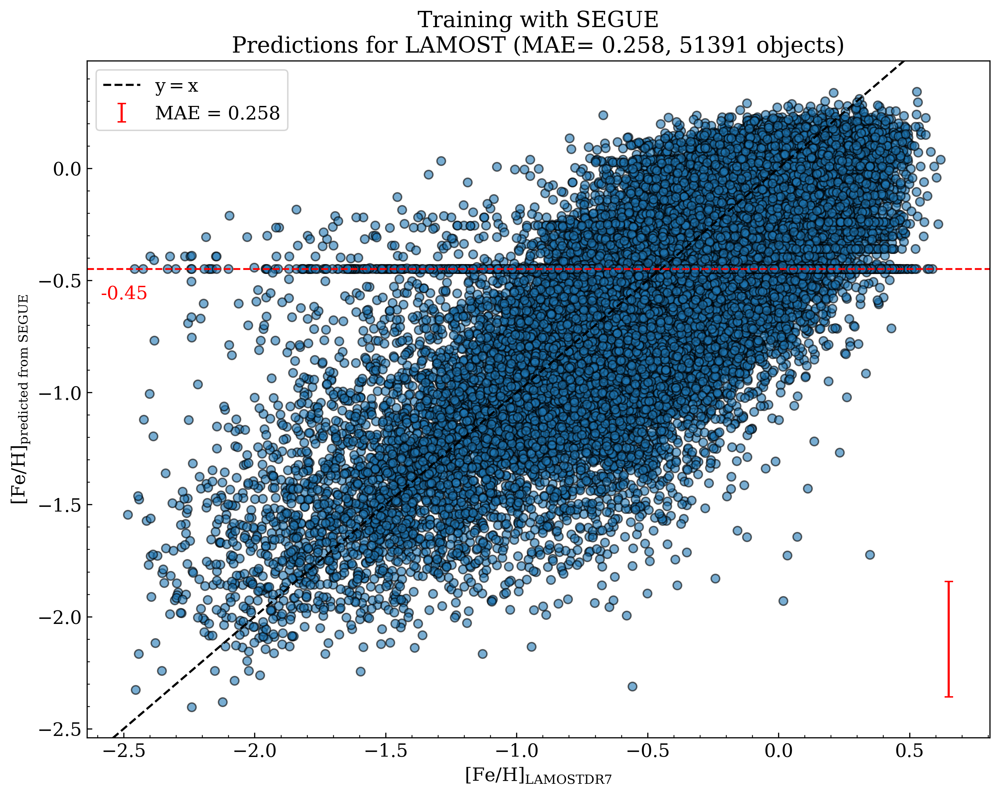

In [24]:
plt.scatter(splusxlamostdr7['feh'], splusxlamostdr7['feh_pred_seguetrain'],
            alpha=0.6, c='C0', edgecolors='k')
plt.errorbar(0.65, -2.1, yerr=MAE_segue_lamost, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
             % (MAE_segue_lamost))

plt.xlabel('$\mathregular{[Fe/H]_{LAMOSTDR7}}$')
plt.ylabel('$\mathregular{[Fe/H]_{predicted~from~SEGUE}}$')
lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]
# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.axhline(stat.mode(splusxlamostdr7['feh_pred_seguetrain']), color='r', ls='--', lw=1.3)
plt.text(x=np.min(plt.gca().get_xlim())*0.98,y=stat.mode(splusxlamostdr7['feh_pred_seguetrain'])*1.3,
         color='r', s='%.2f' % (stat.mode(splusxlamostdr7['feh_pred_seguetrain'])))

plt.title('Training with SEGUE\nPredictions for LAMOST (MAE= %.3f, %i objects)'
          % (MAE_segue_lamost, len(splusxlamostdr7)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelPred_SPLUSxSEGUE_LAMOSTDR7.jpg')
plt.show()

## Previsões para o catálogo do SPLUS

In [25]:
splus = pd.read_csv('sample_SPLUS.csv')

In [26]:
splusfilters = splus.columns[3:27:2]
splusfilterserr = splus.columns[4:27:2]

for mag,err in zip(splusfilters, splusfilterserr):
    splus = splus[(splus[mag]<30) & (splus[err]<1)]

splus.head()
# len(splus)

,ID,ra,DEC,u_auto,e_u_auto,g_auto,e_g_auto,r_auto,e_r_auto,i_auto,e_i_auto,z_auto,e_z_auto,J0378_auto,e_J0378_auto,J0395_auto,e_J0395_auto,J0410_auto,e_J0410_auto,J0430_auto,e_J0430_auto,J0515_auto,e_J0515_auto,J0660_auto,e_J0660_auto,J0861_auto,e_J0861_auto
4,DR2.HYDRA-0011.052515,149.911590,-23.693350,15.323322,0.003318,13.886346,0.001277,13.188625,0.000846,13.086381,0.000846,13.099735,0.001031,14.650993,0.003450,14.241410,0.003992,13.773487,0.002804,13.686386,0.002633,13.275282,0.001831,13.084420,0.001239,12.959021,0.001707
6,DR2.HYDRA-0011.049388,149.911846,-23.740448,20.459211,0.141935,18.347706,0.016752,17.144663,0.006875,16.944075,0.007239,16.791683,0.010365,19.538492,0.107062,18.872938,0.101058,18.446695,0.061160,18.174564,0.047450,17.343985,0.019446,16.846628,0.009123,16.582323,0.015664
9,DR2.HYDRA-0011.063558,149.912290,-23.489622,18.192213,0.020128,16.770014,0.005650,16.347961,0.004151,16.216099,0.004388,16.193840,0.006398,17.866566,0.025508,17.750504,0.037801,17.121431,0.020413,17.006742,0.018340,16.600348,0.011207,16.337915,0.006538,16.227282,0.011669
11,DR2.HYDRA-0011.072833,149.912669,-23.412323,19.438711,0.048047,18.225433,0.013484,17.785692,0.009562,17.676989,0.010899,17.579966,0.016648,19.373390,0.076364,18.747675,0.074983,18.350525,0.047270,18.441814,0.049770,17.983890,0.027483,17.785757,0.015564,17.649220,0.031408
13,DR2.HYDRA-0011.056759,149.912919,-23.610245,19.874104,0.096608,17.635815,0.010809,16.363602,0.004425,15.524368,0.003059,15.116618,0.003338,20.194950,0.221115,20.167570,0.370220,18.899609,0.103492,18.727468,0.086803,17.487284,0.024041,16.039856,0.005792,15.214649,0.006335


In [27]:
# lamost predictions
photofeh_lamost = model_lamost.predict(splus[splusfilters])

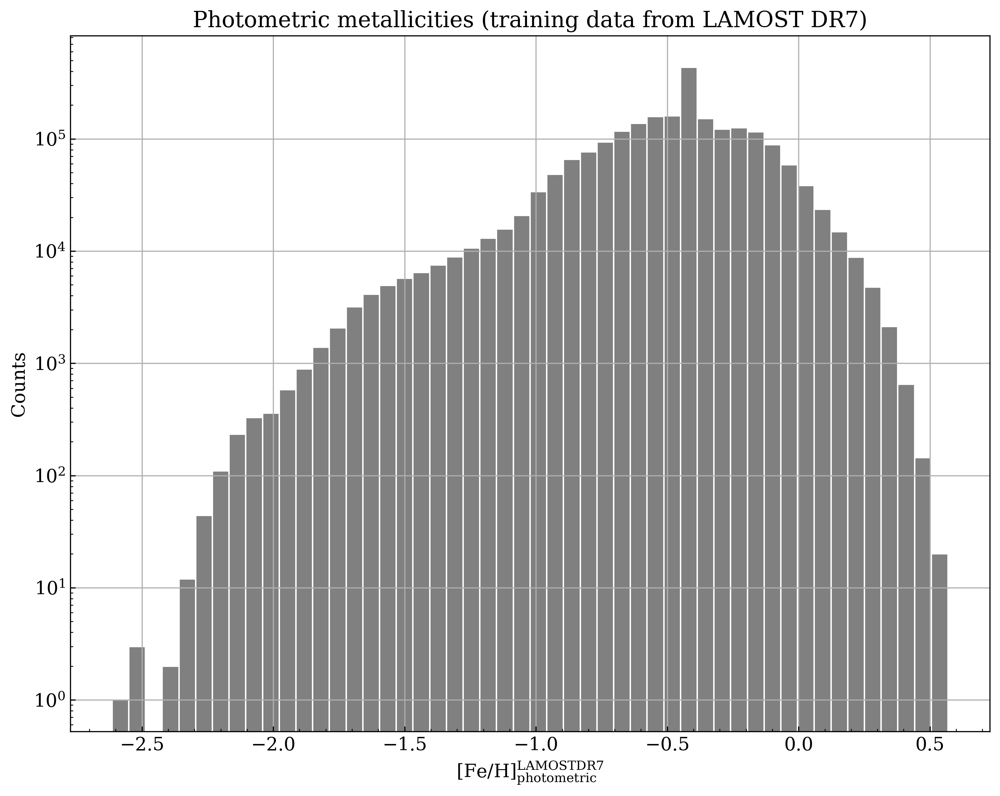

In [28]:
plt.hist(photofeh_lamost, bins=50, color='gray', histtype='bar', ec='white', lw=1)
plt.yscale('log')
plt.xlabel('$\mathregular{[Fe/H]_{photometric}^{LAMOSTDR7}}$')
plt.ylabel('Counts')
plt.title('Photometric metallicities (training data from LAMOST DR7)')
plt.grid()
plt.tight_layout()
plt.savefig('plot_hist_photofeh_SPLUS_LAMOSTDR7train.jpg')
plt.show()

In [29]:
# segue predictions
photofeh_segue = model_segue.predict(splus[splusfilters])

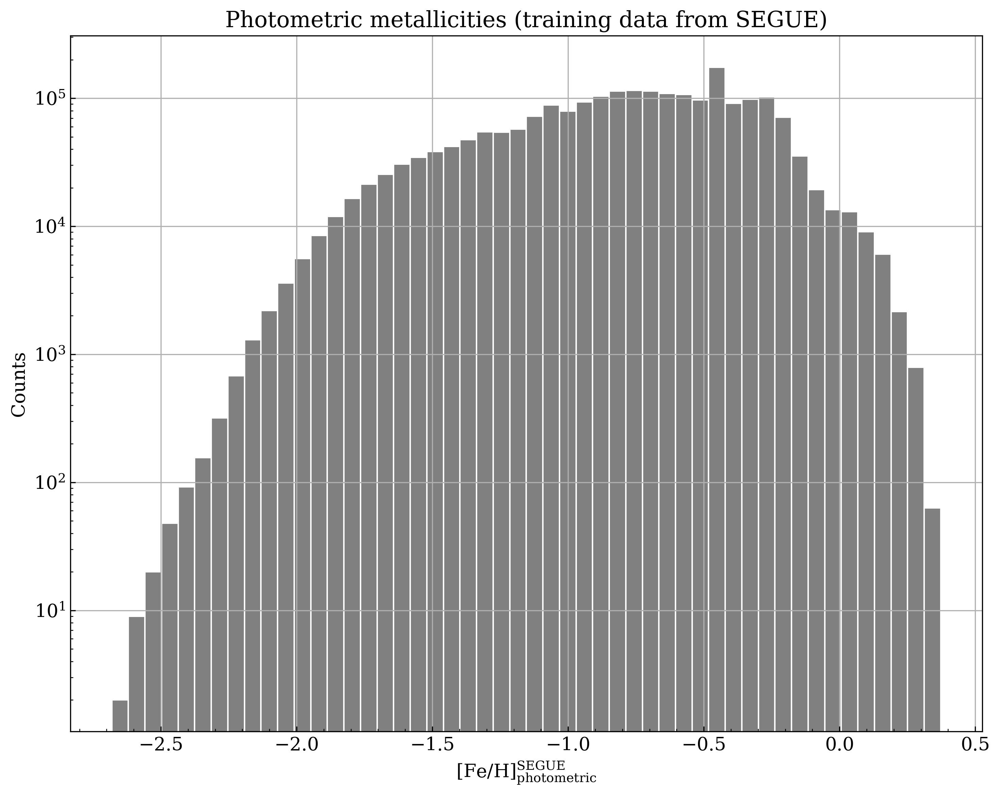

In [30]:
plt.hist(photofeh_segue, bins=50, color='gray', histtype='bar', ec='white', lw=1)
plt.yscale('log')
plt.xlabel('$\mathregular{[Fe/H]_{photometric}^{SEGUE}}$')
plt.ylabel('Counts')
plt.title('Photometric metallicities (training data from SEGUE)')
plt.grid()
plt.tight_layout()
plt.savefig('plot_hist_photofeh_SPLUS_SEGUEtrain.jpg')
plt.show()

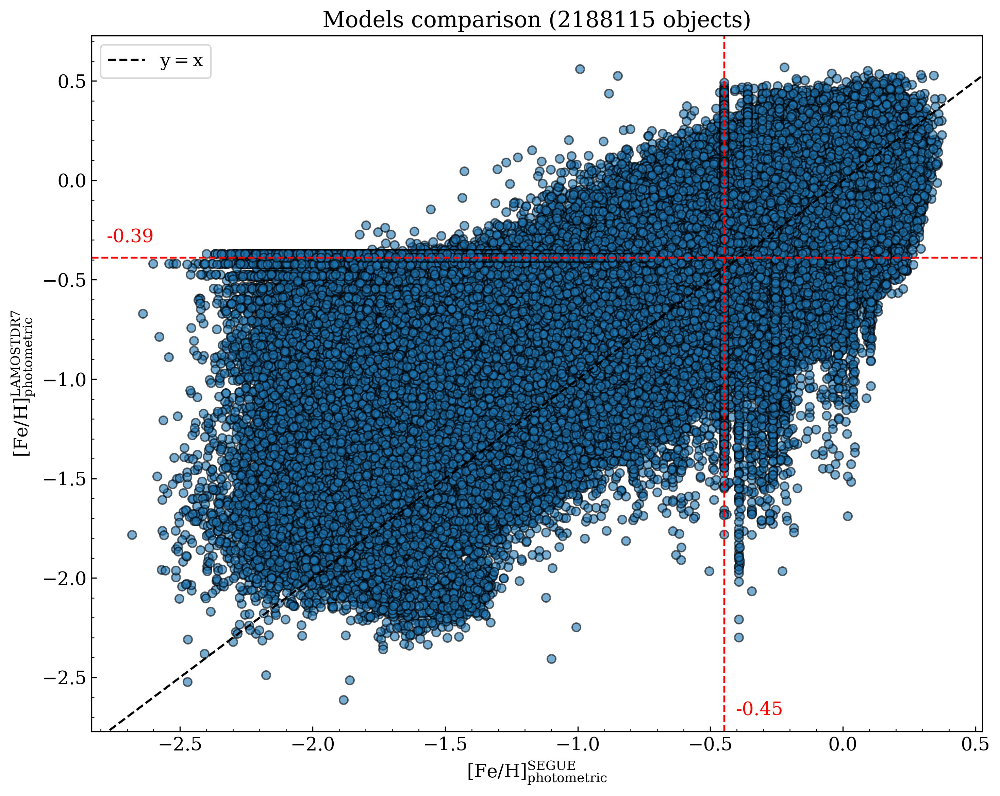

In [31]:
plt.scatter(photofeh_segue, photofeh_lamost,
            alpha=0.6, c='C0', edgecolors='k')

# plt.errorbar(x, y, yerr=MAE, fmt='none', capsize=3, lw=1.5, color='red', label='MAE = %0.3f'
#              % (MAE))

plt.xlabel('$\mathregular{[Fe/H]_{photometric}^{SEGUE}}$')
plt.ylabel('$\mathregular{[Fe/H]_{photometric}^{LAMOSTDR7}}$')

lims = [
    np.min([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # min of both axes
    np.max([plt.gca().get_xlim(), plt.gca().get_ylim()]),  # max of both axes
]
# now plot both limits against eachother
plt.autoscale(False)
plt.plot(lims, lims, 'k--', label="$\mathregular{y=x}$", zorder=2)

plt.axhline(stat.mode(photofeh_lamost), color='r', ls='--', lw=1.3)
plt.text(x=np.min(plt.gca().get_xlim())*0.98,y=stat.mode(photofeh_lamost)*0.8,
         color='r', s='%.2f' % (stat.mode(photofeh_lamost)))

plt.axvline(stat.mode(photofeh_segue), color='r', ls='--', lw=1.3)
plt.text(x=stat.mode(photofeh_segue)*0.9,y=np.min(plt.gca().get_ylim())*0.97,
         color='r', s='%.2f' % (stat.mode(photofeh_segue)))

plt.title('Models comparison (%i objects)'
          % (len(photofeh_segue)))
plt.legend()
plt.tight_layout()
plt.savefig('plot_ModelCompar_SEGUE_LAMOSTDR7.jpg')
plt.show()